# **✨ KEY IMPROVEMENTS ✨**
🖼️ Tap on image is now replaced with label selection.

🎯 Open vocabulary object detection + 🧩 MobileSAM = Segment ANYTHING.

⏱️ Reduced segmentation time by downloading the required segment, not every segment.

✍️ No need for the user to type in the prompt.

🤖 Leveraged GPT-4 to automatically generate dramatic prompts.

⚡ Generation time for 3 dramatic images = 3 x 5 = 15 seconds.

📝 Detailed Captioning of the image is now available.


# SETUP

In [1]:
### currently only dramatic effects for skies are automated
### no. of prompts = no. of outputs generated

PROMPTS_DICT = {
    'sky' : [
              "dramatic sky",
              "dramatic sky, gradient, colors",
              "dramatic sky, large sun if day, large moon if night"
             ],
}

## Install and Import Libraries

In [2]:
!pip install diffusers ultralytics gradio-client openai google-generativeai

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 877.1/877.1 kB 33.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 319.8/319.8 kB 25.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 386.9/386.9 kB 29.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.4/76.4 kB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.0/78.0 kB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 325.2/325.2 kB 29.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 130.2/130.2 kB 11.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 kB 5.0 MB/s eta 0:00:00


In [3]:
from ultralytics import SAM
from gradio_client import Client, handle_file
import json
from PIL import Image
import numpy as np
import os
import matplotlib.pyplot as plt

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [4]:
from diffusers import StableDiffusionControlNetInpaintPipeline, ControlNetModel, UniPCMultistepScheduler
from diffusers.utils import load_image, make_image_grid
import numpy as np
import torch

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

In [5]:
from openai import OpenAI
import ast

## OpenAI Setup

Add your OpenAI API Key at-- "Enter your OpenAI API key:"

each time you run the code.

In [20]:
import os
from getpass import getpass

# Use getpass to securely enter the OpenAI API key
os.environ['OPENAI_API_KEY'] = getpass("Enter your OpenAI API key:")

openai_api_key = os.getenv('OPENAI_API_KEY')

if not openai_api_key:
    raise ValueError("OpenAI API key not found. Please set the environment variable OPENAI_API_KEY.")

# Use the API key in the rest of your code
prompt_client = OpenAI(api_key=openai_api_key)


Enter your OpenAI API key:··········


In [7]:
def generate_dramatic_prompts(label, caption):
    # Prompt for the LLM to generate artistic styles based on the label and caption
    prompt = f"""
    You are an expert in creating artistic prompts for image inpainting models.
    Given the following label: "{label}" and image description: "{caption}",
    generate 3 unique prompts that can be used to apply dramatic or artistic styles specifically to the '{label}' in the image.
    Make the prompts descriptive, relevant to the label, and suitable for artistic enhancement. Keep the prompts concise.
    In suitable scenarios, prioritize prompts containing enhanced celestical characteristics like enlarged celestial bodies example: 'large moon' or 'large sun'.

    For example:
    Label: "The sky"
    Caption: "The image shows a group of people standing on a beach at sunset. The sky is a beautiful shade of pink and purple, with the sun setting over the horizon. The water is a deep blue, with small waves crashing onto the shore. The people are silhouetted against the sky, and they are standing close together, facing the ocean. They are all wearing casual clothes and appear to be enjoying the moment. The overall mood of the image is peaceful and serene."

    Outputs:
    ["Dramatic sky, glowing full moon, rich colors","Dramatic sky, vibrant gradient of orange and purple at sunset","Dramatic sky, dark clouds, intense sunset, glowing horizon"]

    Now, provide 3 prompts for the label "{label}" based on the following image description: {caption}.
    The output should be a plain string in the format '[<prompt1, prompt2, prompt3>]' compatible with the function ast.literal_eval() in python, so that the output upon running the function returns a list.
    """

    response =  prompt_client.chat.completions.create(
      model="gpt-4o",
      messages= [
          {
            "role": "user",
            "content": [
              {
                "type": "text",
                "text": prompt
              }
              ]
          }
      ]
    )

    # Extract and return the generated prompts
    generated_prompts = response.choices[0].message.content.replace("\n", "")
    return ast.literal_eval(generated_prompts)

## Segmentation setup

In [8]:
#~INIT
client = Client("gokaygokay/Florence-2")
mobile_sam_model = SAM("mobile_sam.pt")
#~END

Loaded as API: https://gokaygokay-florence-2.hf.space ✔


100%|██████████| 38.8M/38.8M [00:01<00:00, 39.3MB/s]


In [9]:
def get_json(image_source):
    result = client.predict(
            image=handle_file(image_source),
            task_prompt="More Detailed Caption + Grounding",
            text_input=None,
            model_id="microsoft/Florence-2-large",
            api_name="/process_image"
    )
    tuple_data = result
    json_like_string = tuple_data[0]
    valid_json_string = json_like_string.replace("'", '"')
    json_data = json.loads(valid_json_string)
    return json_data

In [ ]:
##########################################    UNUSED FUNCTION      ##########################################

# def download_segments(json_data):
      # """
      # Downloads every single segment present in their image
      # """
#     out_data = json_data["<CAPTION_TO_PHRASE_GROUNDING>"]
#     all_boxes = json_data["<CAPTION_TO_PHRASE_GROUNDING>"]['bboxes']
#     os.makedirs(image_source[0:5], exist_ok=True)
#     for i in range(len(all_boxes)):
#         results = mobile_sam_model.predict(source=image_source, bboxes = all_boxes[i], labels = [1] )
#         new_masks = results[0].masks
#         mask_array = new_masks.data[0].cpu().numpy()
#         binary_mask = (mask_array > 0.5).astype(np.uint8) * 255
#         mask_image = Image.fromarray(binary_mask)
#         mask_image.save(f"./.{image_source[0:5]}/{out_data['labels'][i]}-{i}.png")

In [10]:
def download_single_segment(image_source,json_data, index_to_enhance):
  """
  Segments the user choice part of the image and then returns the path of the downloaded segment.
  """
  os.makedirs(f".{image_source[0:5]}", exist_ok=True)
  bboxes = json_data["<CAPTION_TO_PHRASE_GROUNDING>"]['bboxes']
  labels = json_data["<CAPTION_TO_PHRASE_GROUNDING>"]['labels']
  result = mobile_sam_model.predict(source = image_source, bboxes = bboxes[index_to_enhance], labels = [1])
  new_masks = result[0].masks
  mask_array = new_masks.data[0].cpu().numpy()
  binary_mask = (mask_array > 0.5).astype(np.uint8) * 255
  mask_image = Image.fromarray(binary_mask)
  mask_image.save(f"./.{image_source[0:5]}/{labels[index_to_enhance]}.png")

  downloaded_segment_path = f".{image_source[0:5]}/{labels[index_to_enhance]}.png"
  return downloaded_segment_path, labels[index_to_enhance]

## Diffusion Setup

In [11]:
controlnet = ControlNetModel.from_pretrained("lllyasviel/control_v11p_sd15_inpaint", torch_dtype=torch.float16, use_safetensors=True)
pipe = StableDiffusionControlNetInpaintPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5", controlnet=controlnet, torch_dtype=torch.float16, use_safetensors=True
)

pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)
pipe.enable_model_cpu_offload()

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/998 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/1.45G [00:00<?, ?B/s]

model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/308 [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

safety_checker/config.json:   0%|          | 0.00/4.72k [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


In [12]:
def make_inpaint_condition(image, image_mask):
    image = np.array(image.convert("RGB")).astype(np.float32) / 255.0
    image_mask = np.array(image_mask.convert("L")).astype(np.float32) / 255.0

    assert image.shape[0:1] == image_mask.shape[0:1]
    image[image_mask > 0.5] = -1.0  # set as masked pixel
    image = np.expand_dims(image, 0).transpose(0, 3, 1, 2)
    image = torch.from_numpy(image)
    return image


## Demo Setup

In [13]:
def process_image(image_source, json_data):
  labels = json_data["<CAPTION_TO_PHRASE_GROUNDING>"]['labels']
  image_caption = json_data["<MORE_DETAILED_CAPTION>"]
  print(image_caption.replace(".", "\n"))
  print("Here are some things that we found in your picture that you may wanna enhance")
  print("Choose what you want to enhance")
  print(f"Eg. Choose 1 for {labels[0]}\n\n")

  for i in range(len(labels)):
    print(f"{i+1} : {labels[i].title()}")

  index_to_enhance = int(input("\n\nEnter your choice: "))
  index_to_enhance = index_to_enhance - 1

  selected_bounding_box = json_data["<CAPTION_TO_PHRASE_GROUNDING>"]['bboxes'][index_to_enhance]
  selected_label = json_data["<CAPTION_TO_PHRASE_GROUNDING>"]['labels'][index_to_enhance]

  PROMPTS_DICT[selected_label] = generate_dramatic_prompts(selected_label, image_caption)


  return download_single_segment(image_source,json_data, index_to_enhance)

In [14]:
def make_image_ready(image_source, segmented_mask_source):
  init_image = load_image(image_source) #image name
  init_image = init_image.resize((512, 512))
  mask_image = load_image(segmented_mask_source) #segmentation mask name
  mask_image = mask_image.resize((512, 512))
  make_image_grid([init_image, mask_image], rows=1, cols=2)

  control_image = make_inpaint_condition(init_image, mask_image)

  return init_image, mask_image, control_image

In [15]:
def dramatize(init_image,
              mask_image,
              control_image,
              output_folder_path,
              segmented_mask_label
              ):
  # os.makedirs(output_folder_path, exist_ok=True)
  for dramatic_prompt in PROMPTS_DICT[segmented_mask_label]:
    output = pipe(
        dramatic_prompt, #enter prompt
        num_inference_steps=20,
        eta=1.0,
        image=init_image,
        mask_image=mask_image,
        control_image=control_image,
    ).images[0]
    output.save(f"./{output_folder_path}/op-{dramatic_prompt}.png")
    # make_image_grid([init_image, mask_image, output], rows=1, cols=3)

In [16]:
def show_all_outputs(output_folder_path):
    files = os.listdir(output_folder_path)

    # Filter the files that start with 'op-' and end with '.png'
    op_images = [f for f in files if f.startswith('op-') and f.endswith('.png')]

    # Determine the number of images
    num_images = len(op_images)

    # Set up a figure with a single row and as many columns as images
    fig, axes = plt.subplots(1, num_images, figsize=(num_images * 5, 5))  # Adjust the size as necessary

    # Display the filtered images
    for ax, image_file in zip(axes, op_images):
        image_path = os.path.join(output_folder_path, image_file)
        image = Image.open(image_path)

        ax.imshow(image)
        ax.axis('off')  # Hide axes for better display
        ax.set_title(image_file)  # Optionally show image filename as title

    plt.tight_layout()
    plt.show()

# DEMO

In [17]:
def run_demo():
  segmented_mask_source, segmented_mask_label = process_image(image_source, json_data)
  print("Your mask has been saved as ", segmented_mask_source)
  init_image, mask_image, control_image = make_image_ready(image_source, segmented_mask_source)
  output_folder_path = f".{image_source[0:5]}"
  dramatize(init_image, mask_image, control_image, output_folder_path,segmented_mask_label)
  show_all_outputs(output_folder_path)

The image shows a young man standing on a yellow railing overlooking the ocean. He is wearing a white t-shirt and khaki pants and sunglasses. He has his arms stretched out to the sides and is looking out towards the horizon. The ocean is a beautiful turquoise color and there are several boats visible in the distance. The sky is clear and blue, and the horizon is lined with trees and buildings. The man appears to be relaxed and enjoying the view.
Here are some things that we found in your picture that you may wanna enhance
Choose what you want to enhance
Eg. Choose 1 for a young man


1 : A Young Man
2 : Yellow Railing
3 : T-Shirt
4 : Sunglasses
5 : The Ocean
6 : Several Boats
7 : Several Boats
8 : The Sky
9 : The Man
10 : The Man


Enter your choice: 5

image 1/1 /content/bijendar.png: 1024x1024 1 0, 85.7ms
Speed: 6.8ms preprocess, 85.7ms inference, 2.6ms postprocess per image at shape (1, 3, 1024, 1024)
Your mask has been saved as  .bijen/The ocean.png


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

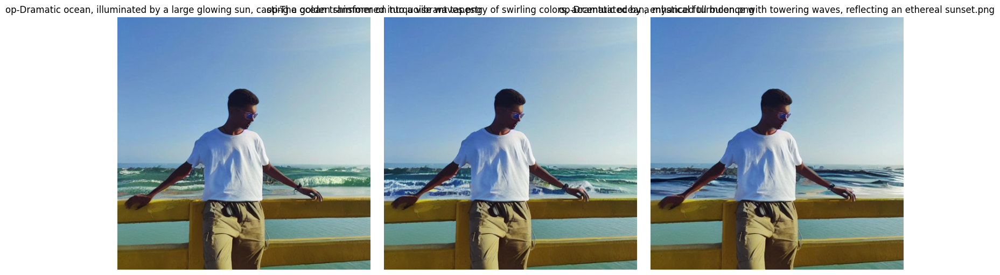

In [ ]:
image_source = "bijendar.png"
json_data = get_json(image_source)
run_demo()

The image shows a young man standing on a yellow railing overlooking the ocean. He is wearing a white t-shirt and khaki pants and sunglasses. He has his arms stretched out to the sides and is looking out towards the horizon. The ocean is a beautiful turquoise color and there are several boats visible in the distance. The sky is clear and blue, and the horizon is lined with trees and buildings. The man appears to be relaxed and enjoying the view.
Here are some things that we found in your picture that you may wanna enhance
Choose what you want to enhance
Eg. Choose 1 for a young man


1 : A Young Man
2 : Yellow Railing
3 : T-Shirt
4 : Sunglasses
5 : The Ocean
6 : Several Boats
7 : Several Boats
8 : The Sky
9 : The Man
10 : The Man


Enter your choice: 3

image 1/1 /content/bijendar.png: 1024x1024 1 0, 112.5ms
Speed: 30.2ms preprocess, 112.5ms inference, 5.6ms postprocess per image at shape (1, 3, 1024, 1024)
Your mask has been saved as  .bijen/t-shirt.png


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

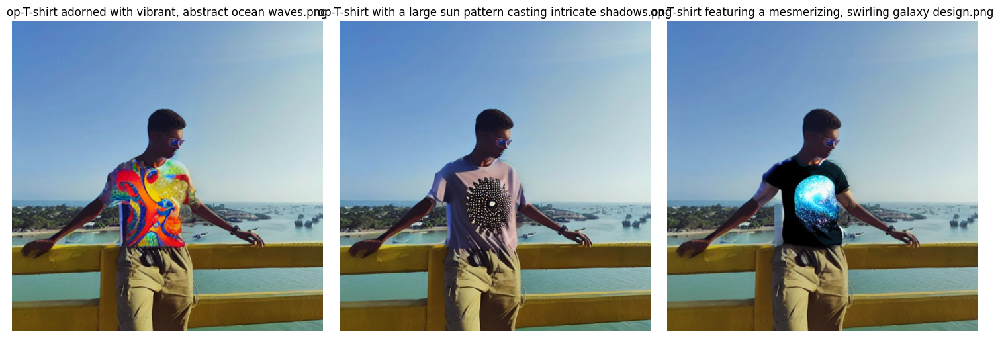

In [ ]:
image_source = "bijendar.png"
json_data = get_json(image_source)
run_demo()

The image shows a large stadium filled with spectators
 The stands are filled with red and white striped scarves, and the sky is blue with a few clouds
 In the center of the image, there is a soccer field with a group of players on the field
 The players are wearing red jerseys and are in the middle of a match
 The crowd is cheering and waving red scarves in the air
 The image appears to be taken from inside the stadium, looking out onto the field from the stands

Here are some things that we found in your picture that you may wanna enhance
Choose what you want to enhance
Eg. Choose 1 for The stands


1 : The Stands
2 : The Stands
3 : The Sky
4 : A Soccer Field
5 : The Players
6 : The Crowd
7 : The Crowd
8 : Red Scarves


Enter your choice: 3

image 1/1 /content/Football.jpeg: 1024x1024 1 0, 93.7ms
Speed: 10.8ms preprocess, 93.7ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)
Your mask has been saved as  .Footb/the sky.png


/usr/local/lib/python3.10/dist-packages/diffusers/configuration_utils.py:140: FutureWarning: Accessing config attribute `vae_latent_channels` directly via 'VaeImageProcessor' object attribute is deprecated. Please access 'vae_latent_channels' over 'VaeImageProcessor's config object instead, e.g. 'scheduler.config.vae_latent_channels'.
  deprecate("direct config name access", "1.0.0", deprecation_message, standard_warn=False)


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

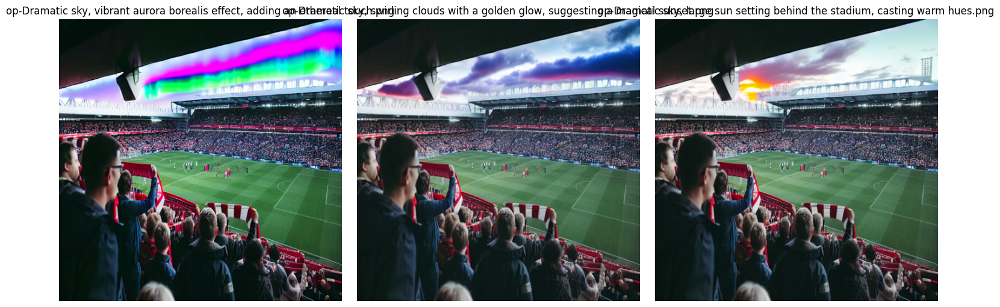

In [ ]:
image_source = "Football.jpeg"
json_data = get_json(image_source)
run_demo()

The image shows a large stadium filled with spectators
 The stands are filled with red and white striped scarves, and the sky is blue with a few clouds
 In the center of the image, there is a soccer field with a group of players on the field
 The players are wearing red jerseys and are in the middle of a match
 The crowd is cheering and waving red scarves in the air
 The image appears to be taken from inside the stadium, looking out onto the field from the stands

Here are some things that we found in your picture that you may wanna enhance
Choose what you want to enhance
Eg. Choose 1 for The stands


1 : The Stands
2 : The Stands
3 : The Sky
4 : A Soccer Field
5 : The Players
6 : The Crowd
7 : The Crowd
8 : Red Scarves


Enter your choice: 4

image 1/1 /content/Football.jpeg: 1024x1024 1 0, 96.4ms
Speed: 10.5ms preprocess, 96.4ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)
Your mask has been saved as  .Footb/a soccer field.png


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

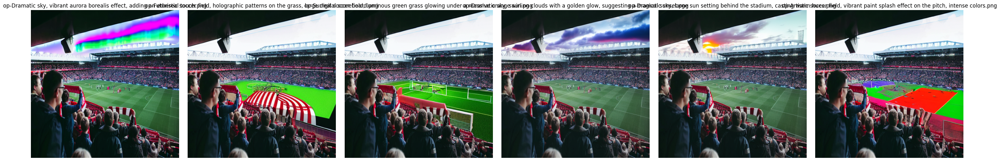

In [ ]:
image_source = "Football.jpeg"
json_data = get_json(image_source)
run_demo()

The image is of a cricket stadium at sunset
 The sky is a beautiful orange and pink color, with the sun setting in the background
 The stadium is filled with spectators, and the stands are filled with people
 The ground is covered in lush green grass, and there is a cricket match being played in progress
 In the center of the image, there are two tall chimneys, one on top of the other, with a flagpole flying the Australian flag
 The chimneys are tall and cylindrical, and they are surrounded by a green roof
 On the left side of the stadium, there is another tall chimney with a clock tower, and on the right side, there appears to be a large crowd of spectators
 The image is taken from the stands, looking down on the field

Here are some things that we found in your picture that you may wanna enhance
Choose what you want to enhance
Eg. Choose 1 for The sky


1 : The Sky
2 : The Stadium
3 : The Ground
4 : The Ground
5 : Tall Chimneys
6 : Tall Chimneys
7 : Tall Chimneys
8 : A Flagpole
9 : T

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

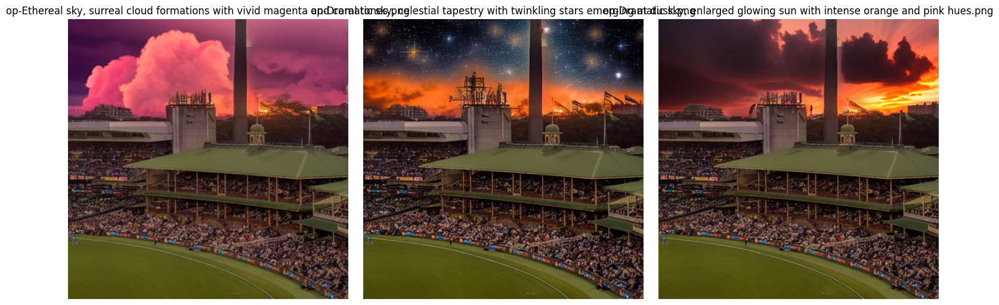

In [ ]:
image_source = "Cricket.jpeg"
json_data = get_json(image_source)
run_demo()

The image is a landscape photograph of a beautiful mountain range
 The sky is blue with a few white clouds scattered across it
 The mountains are covered in snow and have a reddish-brown color
 In the foreground, there is a body of water with a small island in the middle
 The water is calm and reflects the mountains and the sky
 On the left side of the image, there are trees and a few people can be seen walking along the shore
 The overall mood of the photograph is peaceful and serene

Here are some things that we found in your picture that you may wanna enhance
Choose what you want to enhance
Eg. Choose 1 for The sky


1 : The Sky
2 : The Mountains
3 : A Body
4 : The Water
5 : Trees


Enter your choice: 1

image 1/1 /content/Scene1.jpeg: 1024x1024 1 0, 443.9ms
Speed: 197.2ms preprocess, 443.9ms inference, 24.2ms postprocess per image at shape (1, 3, 1024, 1024)
Your mask has been saved as  .Scene/The sky.png


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

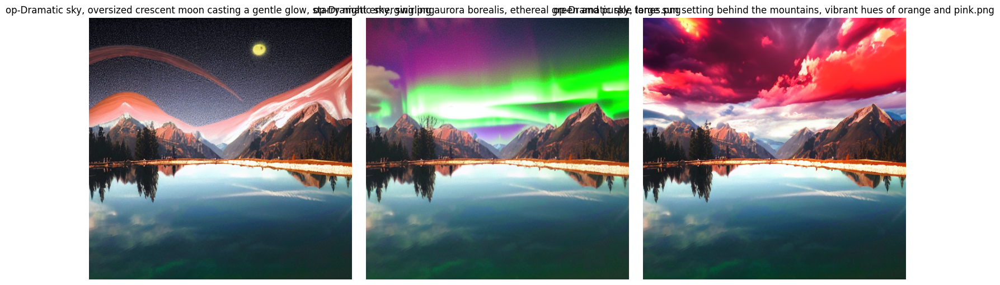

In [ ]:
image_source = "Scene1.jpeg"
json_data = get_json(image_source)
run_demo()

The image is a landscape photograph of a beautiful mountain range
 The sky is blue with a few white clouds scattered across it
 The mountains are covered in snow and have a reddish-brown color
 In the foreground, there is a body of water with a small island in the middle
 The water is calm and reflects the mountains and the sky
 On the left side of the image, there are trees and a few people can be seen walking along the shore
 The overall mood of the photograph is peaceful and serene

Here are some things that we found in your picture that you may wanna enhance
Choose what you want to enhance
Eg. Choose 1 for The sky


1 : The Sky
2 : The Mountains
3 : A Body
4 : The Water
5 : Trees


Enter your choice: 4

image 1/1 /content/Scene1.jpeg: 1024x1024 1 0, 83.9ms
Speed: 7.3ms preprocess, 83.9ms inference, 2.0ms postprocess per image at shape (1, 3, 1024, 1024)
Your mask has been saved as  .Scene/The water.png


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

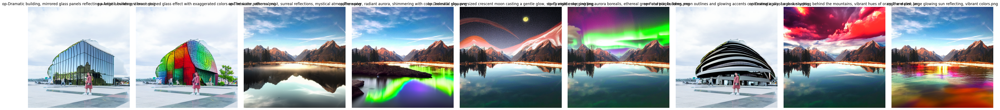

In [ ]:
image_source = "Scene1.jpeg"
json_data = get_json(image_source)
run_demo()

The image is a photograph of a night sky filled with stars
 The sky is dark blue and the stars are scattered across it, creating a starry effect
 The mountains in the background are covered in snow and rocks, and there is a trail of snow leading up to the top of one of the mountains
 The image is taken from a low angle, looking up at the sky
 The overall mood of the image is dramatic and awe-inspiring

Here are some things that we found in your picture that you may wanna enhance
Choose what you want to enhance
Eg. Choose 1 for The sky


1 : The Sky
2 : The Sky
3 : The Mountains
4 : The Mountains
5 : A Trail
6 : A Trail
7 : Snow


Enter your choice: 1

image 1/1 /content/Scene2.jpeg: 1024x1024 1 0, 83.7ms
Speed: 6.3ms preprocess, 83.7ms inference, 0.8ms postprocess per image at shape (1, 3, 1024, 1024)
Your mask has been saved as  .Scene/The sky.png


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

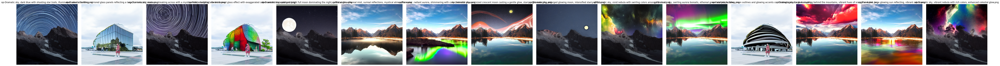

In [ ]:
image_source = "Scene2.jpeg"
json_data = get_json(image_source)
run_demo()

In [ ]:
image_source = "Scene3.jpeg"
json_data = get_json(image_source)
run_demo()

In [ ]:
image_source = "Scene.jpeg"
json_data = get_json(image_source)
run_demo()

In [ ]:
image_source = ""
json_data = get_json(image_source)
run_demo()

In [ ]:
image_source = ""
json_data = get_json(image_source)
run_demo()

In [ ]:
image_source = ""
json_data = get_json(image_source)
run_demo()

In [ ]:
image_source = ""
json_data = get_json(image_source)
run_demo()

# **HOW TO RUN THE NOTEBOOK?**
---

1.   Upload the mobile_sam.pt file in the colab directory
2.   Run all the cells under Setup, Install and Import Libraries
3.   Run all the cells under Segmentation Setup ensure the mobile_sam.pt is passed as parameter in the SAM initialization.
4. Run all the cells under the diffusion setup
5. Set the image_source as the path to your image
6. Choose what item in the image you wanna apply dramatic effect to
7. Apply dramatic effect and see the outputs


[Download mobile_sam.pt](https://drive.google.com/file/d/1UuGRtVtlT_jZz4yv8qnY1C33MYQkZSWh/view?usp=sharing)







In [ ]:
shutil.rmtree(".bijen")